In [2]:
import pandas as pd
import numpy as np
import geopandas as gpd
import glob
import matplotlib.pyplot as plt
import seaborn as sns

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


# All properties

In [3]:
LOSS = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_loss.csv').drop(columns=['Unnamed: 0','count_count'])
HEAT = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_heat.csv').drop(columns=['Unnamed: 0','count_count'])
HOUSE = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_house.csv').drop(columns=['Unnamed: 0'])
ENER = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_energy.csv').drop(columns=['Unnamed: 0','count_count'])
OTHER = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_other.csv').drop(columns=['Unnamed: 0','count_count'])
census = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/Jamie -All households - GB.csv').rename(columns={'LSOA2021_code':'LSOA21CD'})

In [4]:
HOUSE = HOUSE.rename(columns={'count_count':'count_epc'})
data = LOSS.merge(HEAT, on = 'LSOA21CD'
           ).merge(HOUSE, on = 'LSOA21CD'
                   ).merge(ENER, on = 'LSOA21CD'
                           ).merge(OTHER, on = 'LSOA21CD'
                                   ).merge(census.loc[:,['LSOA21CD','Total: All households']], on = 'LSOA21CD', how = 'left' )
data['PROP_EPC_FROM_CENSUS_HOUSE'] = data['count_epc']/data['Total: All households']

In [5]:
LSOA = gpd.read_file('./../../Volumes/Extreme_SSD/WORK/boundaries/LSOA_2021.geojson')
LSOA.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 35672 entries, 0 to 35671
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   OBJECTID  35672 non-null  int32   
 1   LSOA21CD  35672 non-null  object  
 2   LSOA21NM  35672 non-null  object  
 3   GlobalID  35672 non-null  object  
 4   geometry  35672 non-null  geometry
dtypes: geometry(1), int32(1), object(3)
memory usage: 1.2+ MB


In [6]:
data = LSOA.merge(data, on = 'LSOA21CD')

In [7]:
data.to_file('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_data_raw.geojson')

In [8]:
for_rates = ['Roof_insulati_sum', 'Roof_thatch_sum', 'NUMBER_OPEN_FIREPLACES_sum',
       'NUMBER_OPEN_FIREPLACES_binary_sum', 'MAIN_electric_sum',
       'MAIN_solid_fuel_sum', 'MAIN_other_sum', 'MAIN_electric_other_sum',
       'MAIN_electric_solid_sum', 'MAIN_solid_other_sum',
       'SECOND_electric_sum', 'SECOND_solid_fuel_sum', 'SECOND_other_sum',
       'SECOND_electric_other_sum', 'SECOND_electric_solid_sum',
       'SECOND_solid_other_sum', 'MAINS_GAS_FLAG_sum', 
       'Owner-occupied_sum', 'Rented (private)_sum', 'Rented (social)_sum',
       'Detached_sum', 'End-Terrace_sum', 'Mid-Terrace_sum',
       'Semi-Detached_sum', 'Bungalow_sum', 'Flat_sum', 'House_sum',
       'Maisonette_sum', 'Park_home_sum','1976-2002_sum', '1930-1949_sum',
       'before_1929_sum', '1950-1975_sum', '2003_onwards_sum','TOP_FLOOR_FLAT_sum',
       'TRANS_TYPE_other_sum', 'TRANS_TYPE_govdeal_sum','PHOTO_SUPPLY_bi_sum']

for i in for_rates:
    data[i] = data[i]/data['count_epc']


In [9]:
data.to_file('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_data_rates.geojson')

## Outputs

In [10]:
cols_plot = ['MULTI_GLAZE_PROPORTION_median', 'MULTI_GLAZE_PROPORTION_mean',
       'EXTENSION_COUNT_median', 'EXTENSION_COUNT_mean', 'PHOTO_SUPPLY_median',
       'PHOTO_SUPPLY_mean', 'Roof_insulati_sum', 'Roof_thatch_sum',
       'NUMBER_OPEN_FIREPLACES_sum', 'NUMBER_OPEN_FIREPLACES_median',
       'NUMBER_OPEN_FIREPLACES_mean', 'NUMBER_OPEN_FIREPLACES_binary_sum',
       'MAIN_electric_sum', 'MAIN_solid_fuel_sum', 'MAIN_other_sum',
       'MAIN_electric_other_sum', 'MAIN_electric_solid_sum',
       'MAIN_solid_other_sum', 'SECOND_electric_sum', 'SECOND_solid_fuel_sum',
       'SECOND_other_sum', 'SECOND_electric_other_sum',
       'SECOND_electric_solid_sum', 'SECOND_solid_other_sum',
       'TOTAL_FLOOR_AREA_median', 'TOTAL_FLOOR_AREA_mean',
       'MAINS_GAS_FLAG_sum', 'Owner-occupied_sum',
       'Rented (private)_sum', 'Rented (social)_sum', 'Detached_sum',
       'End-Terrace_sum', 'Mid-Terrace_sum', 'Semi-Detached_sum',
       'Bungalow_sum', 'Flat_sum', 'House_sum', 'Maisonette_sum',
       'Park_home_sum','TOP_FLOOR_FLAT_sum', '1976-2002_sum', '1930-1949_sum',
       'before_1929_sum', '1950-1975_sum', '2003_onwards_sum', 'CURRENT_ENERGY_EFFICIENCY_median',
       'CURRENT_ENERGY_EFFICIENCY_mean',
       'CURRENT_ENERGY_RATING_numbered_median',
       'CURRENT_ENERGY_RATING_numbered_mean',
       'ENERGY_CONSUMPTION_CURRENT_median', 'ENERGY_CONSUMPTION_CURRENT_mean',
       'ENERGY_CONSUMPTION_POTENTIAL_median',
       'ENERGY_CONSUMPTION_POTENTIAL_mean',
       'TRANS_TYPE_other_sum', 'TRANS_TYPE_govdeal_sum','PROP_EPC_FROM_CENSUS_HOUSE','PHOTO_SUPPLY_bi_sum']

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 1.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 3.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 2.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 2.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 2.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:

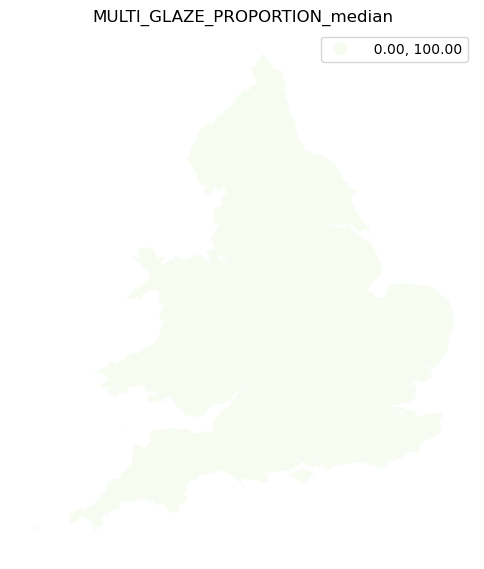

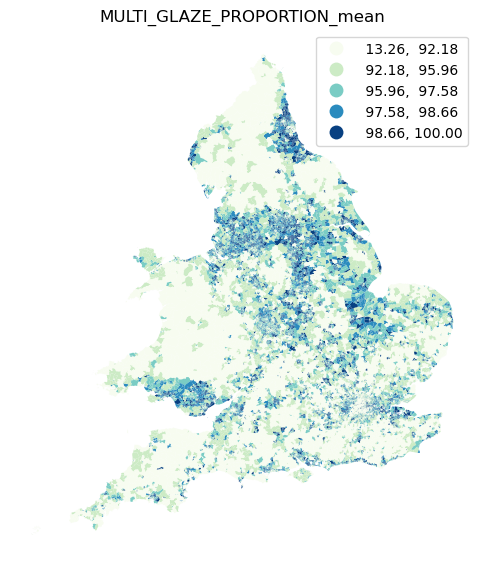

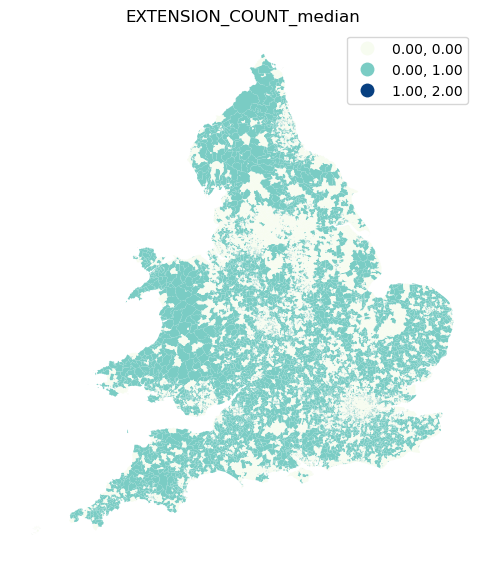

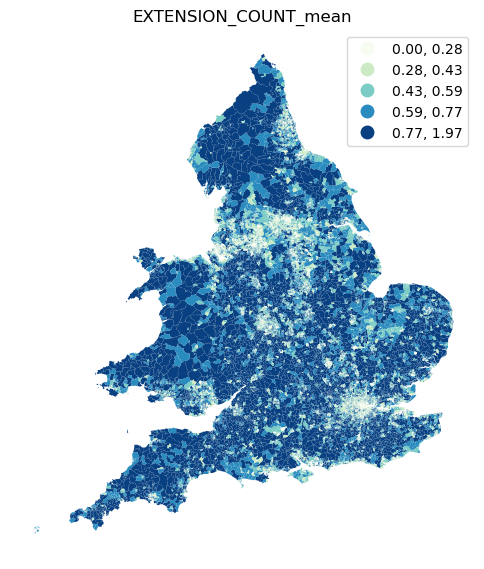

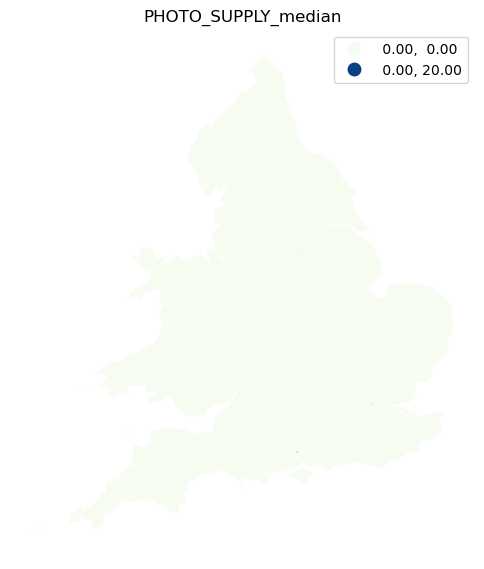

...

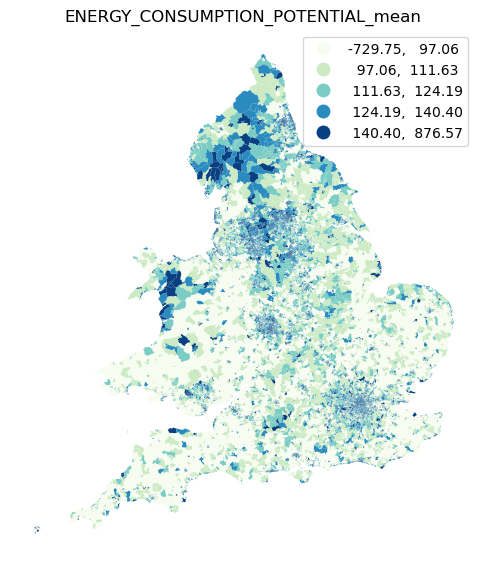

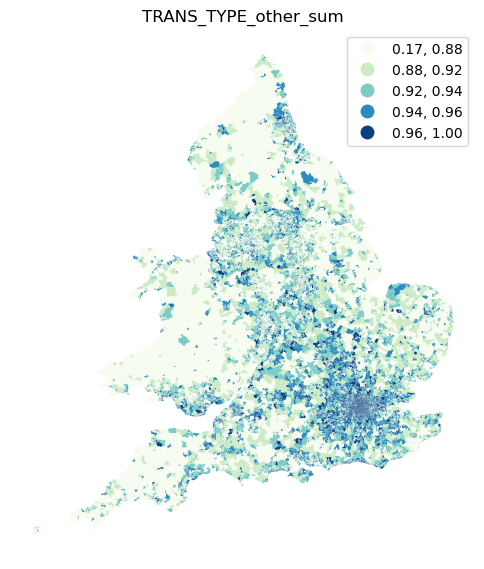

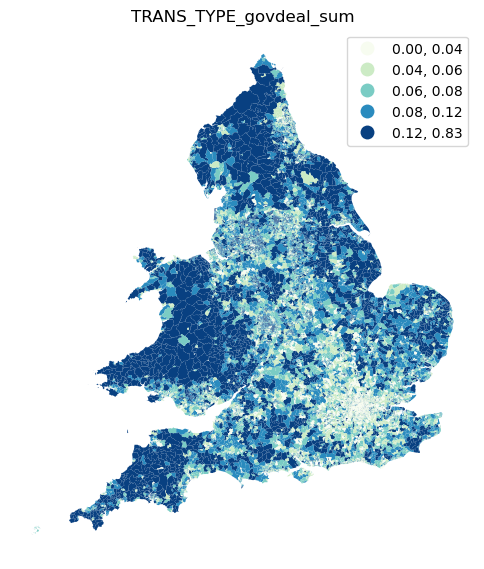

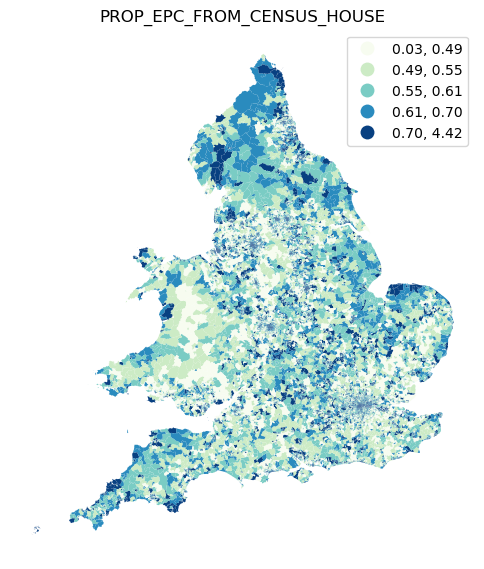

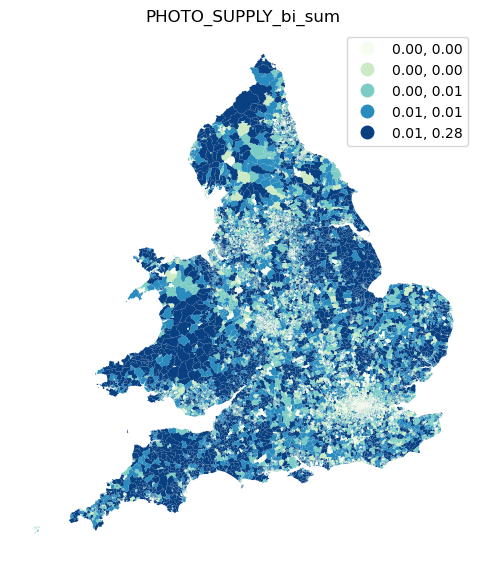

In [11]:
for i in cols_plot:
    ax = data.plot(column = i, legend = True, 
                                            cmap='GnBu',
                                            scheme="quantiles", k=5,
                                            figsize=(6, 8))
    ax.set_axis_off()
    plt.title(i)
    plt.savefig(str('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/english_figures/all_prop/' + i +'.png'))

In [12]:
df = data.loc[:,cols_plot]
corr = df.corr()
corr.style.background_gradient(cmap='coolwarm', axis=None).to_excel('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/english_figures/all_prop_corrs.xlsx')

# GAS only

In [13]:
LOSS = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_GAS_loss.csv').drop(columns=['Unnamed: 0','count_count'])
HEAT = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_GAS_heat.csv').drop(columns=['Unnamed: 0','count_count'])
HOUSE = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_GAS_house.csv').drop(columns=['Unnamed: 0'])
ENER = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_GAS_energy.csv').drop(columns=['Unnamed: 0','count_count'])
OTHER = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/LSOA_GAS_other.csv').drop(columns=['Unnamed: 0','count_count'])
census = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/Jamie -All households - GB.csv').rename(columns={'LSOA2021_code':'LSOA21CD'})

In [14]:
print(len(HOUSE['LSOA21CD']))
print(len(OTHER['LSOA21CD']))
print(len(LOSS['LSOA21CD']))
print(len(HEAT['LSOA21CD']))
print(len(ENER['LSOA21CD']))
print(len(census['LSOA21CD']))


35650
35650
35650
35650
35650
42648


In [15]:
HOUSE = HOUSE.rename(columns={'count_count':'count_epc'})
data = LOSS.merge(HEAT, on = 'LSOA21CD'
           ).merge(HOUSE, on = 'LSOA21CD'
                   ).merge(ENER, on = 'LSOA21CD'
                           ).merge(OTHER, on = 'LSOA21CD'
                                   ).merge(census.loc[:,['LSOA21CD','Total: All households']], on = 'LSOA21CD',how = 'left' )
data['PROP_EPC_FROM_CENSUS_HOUSE'] = data['count_epc']/data['Total: All households']

In [16]:
data = LSOA.merge(data, on = 'LSOA21CD')
data = data[data['count_epc'] >= 5]

In [17]:
data.to_file('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/GAS_LSOA_data_raw.geojson')

In [19]:
for_rates = ['Roof_insulati_sum', 'Roof_thatch_sum', 'NUMBER_OPEN_FIREPLACES_sum',
       'NUMBER_OPEN_FIREPLACES_binary_sum', 'MAIN_electric_sum',
       'MAIN_solid_fuel_sum', 'MAIN_other_sum', 'MAIN_electric_other_sum',
       'MAIN_electric_solid_sum', 'MAIN_solid_other_sum',
       'SECOND_electric_sum', 'SECOND_solid_fuel_sum', 'SECOND_other_sum',
       'SECOND_electric_other_sum', 'SECOND_electric_solid_sum',
       'SECOND_solid_other_sum', 'MAINS_GAS_FLAG_sum', 
       'Owner-occupied_sum', 'Rented (private)_sum', 'Rented (social)_sum',
       'Detached_sum', 'End-Terrace_sum', 'Mid-Terrace_sum',
       'Semi-Detached_sum', 'Bungalow_sum', 'Flat_sum', 'House_sum',
       'Maisonette_sum', 'Park_home_sum',  '1976-2002_sum', '1930-1949_sum',
       'before_1929_sum', '1950-1975_sum', '2003_onwards_sum','TOP_FLOOR_FLAT_sum',
       'TRANS_TYPE_other_sum', 'TRANS_TYPE_govdeal_sum','PHOTO_SUPPLY_bi_sum']

for i in for_rates:
    data[i] = data[i]/data['count_epc']

In [20]:
data.to_file('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/GAS_LSOA_data_rates.geojson')

## Outputs

In [21]:
cols_plot = ['MULTI_GLAZE_PROPORTION_median', 'MULTI_GLAZE_PROPORTION_mean',
       'EXTENSION_COUNT_median', 'EXTENSION_COUNT_mean', 'PHOTO_SUPPLY_median',
       'PHOTO_SUPPLY_mean', 'Roof_insulati_sum', 'Roof_thatch_sum',
       'NUMBER_OPEN_FIREPLACES_sum', 'NUMBER_OPEN_FIREPLACES_median',
       'NUMBER_OPEN_FIREPLACES_mean', 'NUMBER_OPEN_FIREPLACES_binary_sum',
       'MAIN_electric_sum', 'MAIN_solid_fuel_sum', 'MAIN_other_sum',
       'MAIN_electric_other_sum', 'MAIN_electric_solid_sum',
       'MAIN_solid_other_sum', 'SECOND_electric_sum', 'SECOND_solid_fuel_sum',
       'SECOND_other_sum', 'SECOND_electric_other_sum',
       'SECOND_electric_solid_sum', 'SECOND_solid_other_sum',
       'TOTAL_FLOOR_AREA_median', 'TOTAL_FLOOR_AREA_mean',
       'MAINS_GAS_FLAG_sum', 'Owner-occupied_sum',
       'Rented (private)_sum', 'Rented (social)_sum', 'Detached_sum',
       'End-Terrace_sum', 'Mid-Terrace_sum', 'Semi-Detached_sum',
       'Bungalow_sum', 'Flat_sum', 'House_sum', 'Maisonette_sum',
       'Park_home_sum','TOP_FLOOR_FLAT_sum', '1976-2002_sum', '1930-1949_sum',
       'before_1929_sum', '1950-1975_sum', '2003_onwards_sum', 'CURRENT_ENERGY_EFFICIENCY_median',
       'CURRENT_ENERGY_EFFICIENCY_mean',
       'CURRENT_ENERGY_RATING_numbered_median',
       'CURRENT_ENERGY_RATING_numbered_mean',
       'ENERGY_CONSUMPTION_CURRENT_median', 'ENERGY_CONSUMPTION_CURRENT_mean',
       'ENERGY_CONSUMPTION_POTENTIAL_median',
       'ENERGY_CONSUMPTION_POTENTIAL_mean',
       'TRANS_TYPE_other_sum', 'TRANS_TYPE_govdeal_sum','PROP_EPC_FROM_CENSUS_HOUSE','PHOTO_SUPPLY_bi_sum']

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 1.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 3.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 2.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 2.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 2.
  warnings.warn(
/opt/anaconda3/envs/epc/lib/python3.10/site-packages/mapclassify/classifiers.py:

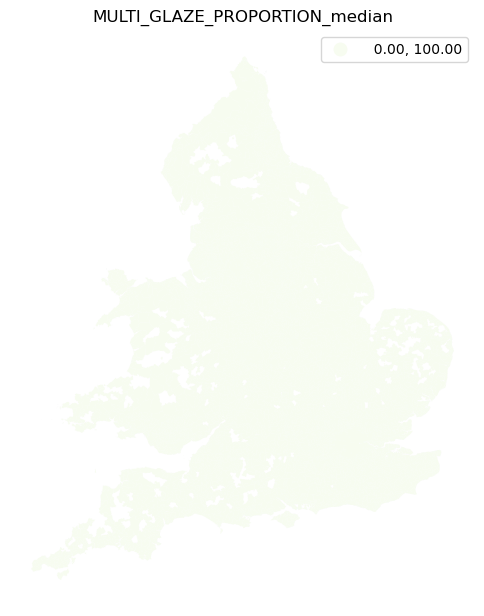

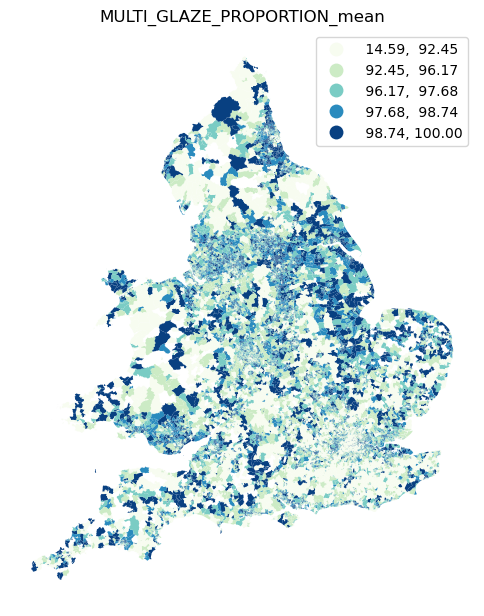

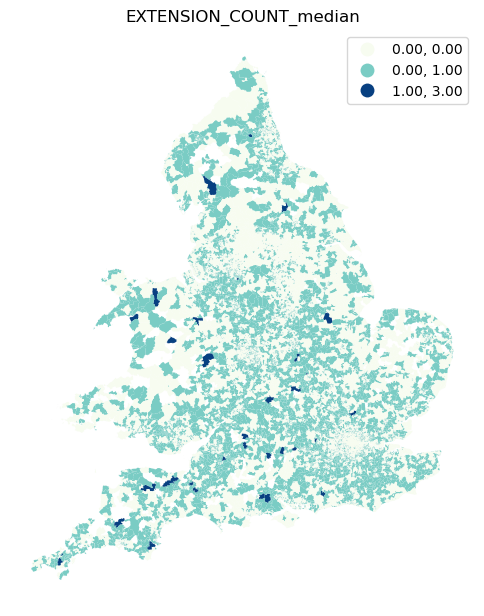

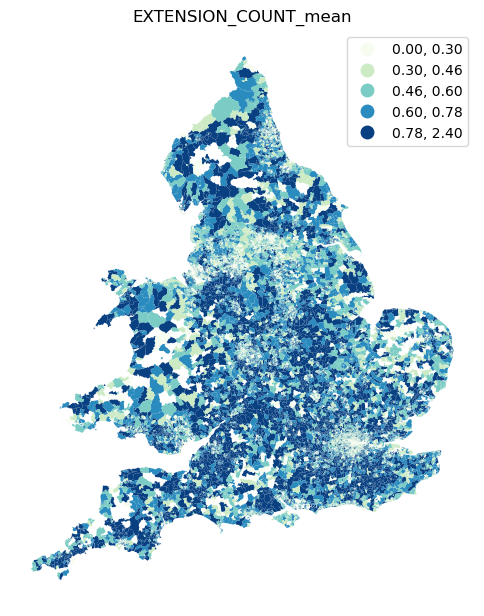

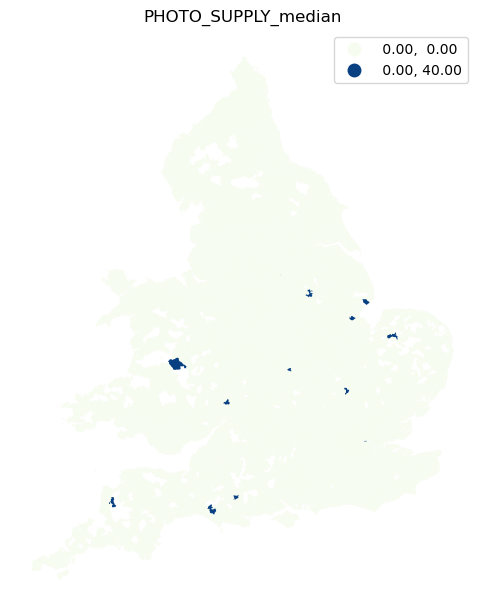

...

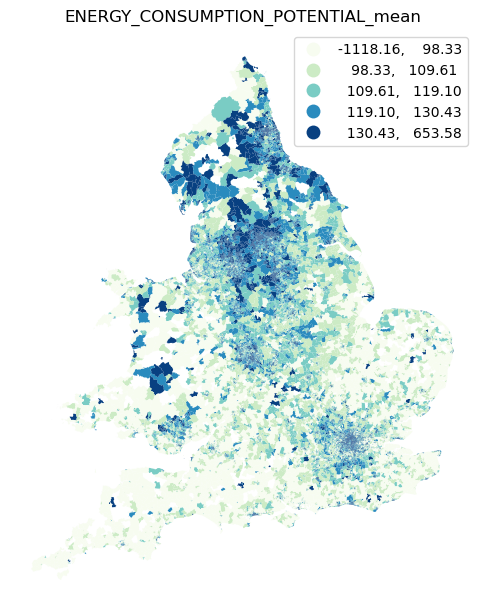

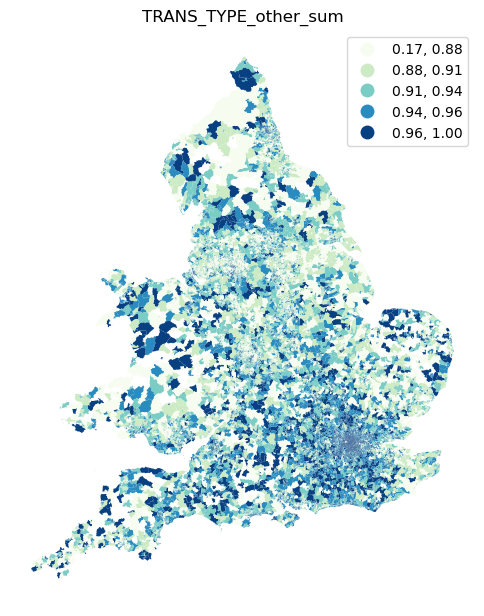

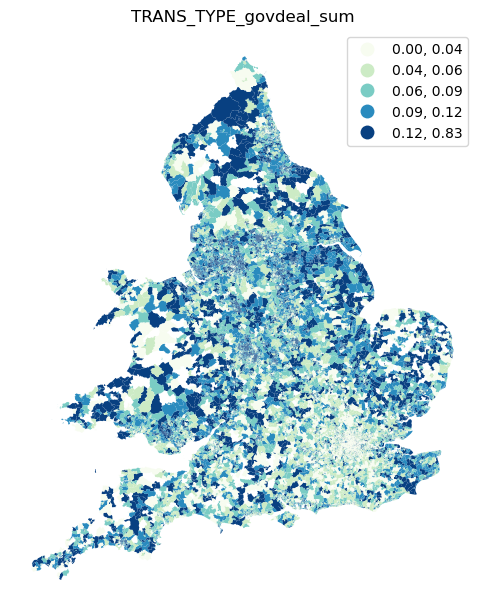

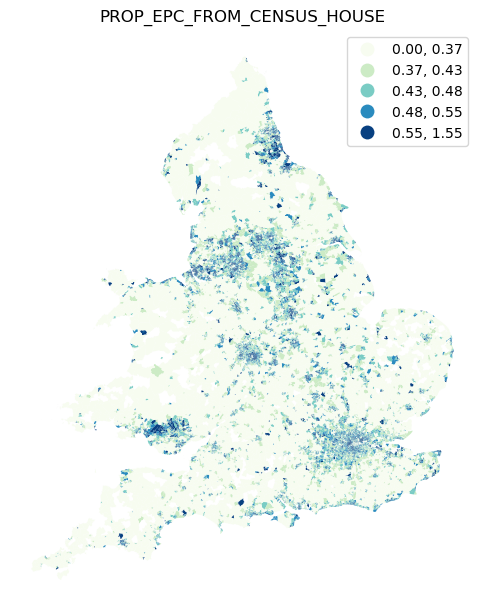

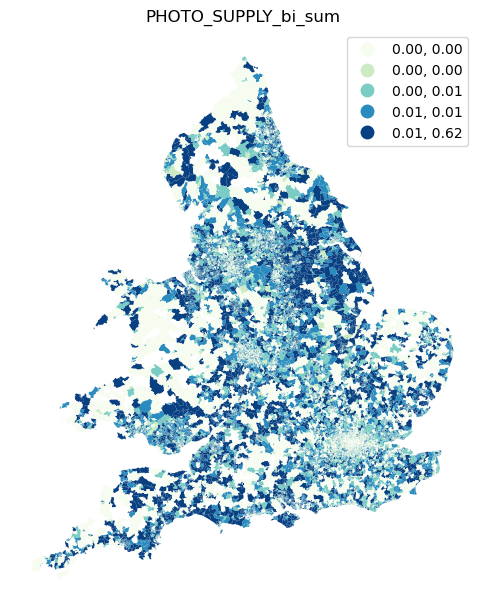

In [22]:
for i in cols_plot:
    ax = data.plot(column = i, legend = True, 
                                            cmap='GnBu',
                                            scheme="quantiles", k=5,
                                            figsize=(6, 8))
    ax.set_axis_off()
    plt.title(i)
    plt.savefig(str('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/english_figures/gas_only/' + i +'.png'))

In [23]:
df = data.loc[:,cols_plot]
corr = df.corr()
corr.style.background_gradient(cmap='coolwarm', axis=None).to_excel('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/english_figures/gas_only_corrs.xlsx')